In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt


### 한글 사용을 위한 준비

In [5]:
import platform
platform.system()

if platform.system() == 'Darwin' :
    plt.rc('font', family = 'AppleGothic')
elif platform.system() == 'Windows' :
    plt.rc('font', family = 'Malgun Gothic')
    
plt.rc('axes', unicode_minus=False)

### 데이터 확인

In [8]:
import csv
f = open('subwayfee.csv', encoding = 'cp949') #
data = csv.reader(f)

for row in data :
    print(row)

['사용월', '호선명', '역ID', '지하철역', '유임승차', '유임하차', '무임승차', '무임하차', '']
['2022-10', '1호선', '0150', '서울역', '1307627', '1279921', '218542', '210320', '']
['2022-10', '1호선', '0151', '시청', '638454', '654541', '119508', '116903', '']
['2022-10', '1호선', '0152', '종각', '893135', '864755', '153798', '143813', '']
['2022-10', '1호선', '0153', '종로3가', '499373', '442702', '319982', '296084', '']
['2022-10', '1호선', '0154', '종로5가', '442041', '447014', '260373', '250139', '']
['2022-10', '1호선', '0155', '동대문', '231006', '219104', '124571', '124404', '']
['2022-10', '1호선', '0156', '신설동', '280677', '270784', '121048', '116766', '']
['2022-10', '1호선', '0157', '제기동', '234930', '222417', '287970', '309026', '']
['2022-10', '1호선', '0158', '청량리(서울시립대입구)', '345240', '346252', '261608', '265382', '']
['2022-10', '1호선', '0159', '동묘앞', '144243', '154090', '166501', '169644', '']
['2022-10', '2호선', '0201', '시청', '615600', '585843', '64011', '57360', '']
['2022-10', '2호선', '0202', '을지로입구', '1117722', '1140577', '103892', 

### 문자형 데이터 정수로 변경

['2022-10', '2호선', '0228', '서울대입구(관악구청)', 1198157, 1170291, 179938, 170672, '']

[0, 1, 2, 3, 4, 5, 6, 7, 8] 이 인덱스 순서인데 우리는 4번째 인덱스부터 8번째 인덱스를 문자에서 정수로 변경해야하기 때문에

In [9]:
f = open('subwayfee.csv', encoding = 'cp949')
data = csv.reader(f)

next(data)

for row in data :
    for i in range(4,8): 
        row[i] = int(row[i])
    print(row)

['2022-10', '1호선', '0150', '서울역', 1307627, 1279921, 218542, 210320, '']
['2022-10', '1호선', '0151', '시청', 638454, 654541, 119508, 116903, '']
['2022-10', '1호선', '0152', '종각', 893135, 864755, 153798, 143813, '']
['2022-10', '1호선', '0153', '종로3가', 499373, 442702, 319982, 296084, '']
['2022-10', '1호선', '0154', '종로5가', 442041, 447014, 260373, 250139, '']
['2022-10', '1호선', '0155', '동대문', 231006, 219104, 124571, 124404, '']
['2022-10', '1호선', '0156', '신설동', 280677, 270784, 121048, 116766, '']
['2022-10', '1호선', '0157', '제기동', 234930, 222417, 287970, 309026, '']
['2022-10', '1호선', '0158', '청량리(서울시립대입구)', 345240, 346252, 261608, 265382, '']
['2022-10', '1호선', '0159', '동묘앞', 144243, 154090, 166501, 169644, '']
['2022-10', '2호선', '0201', '시청', 615600, 585843, 64011, 57360, '']
['2022-10', '2호선', '0202', '을지로입구', 1117722, 1140577, 103892, 95993, '']
['2022-10', '2호선', '0203', '을지로3가', 575411, 568927, 77891, 76037, '']
['2022-10', '2호선', '0204', '을지로4가', 292765, 297553, 79485, 78742, '']
['2022-10

### 유임 승차율이 가장 높은 역 찾기 - division by zero 에러 뜸

In [10]:
f = open('subwayfee.csv', encoding = 'cp949')
data = csv.reader(f)

next(data)
mx = 0
rate = 0

for row in data :
    for i in range(4,8):
        row[i] = int(row[i])
    rate =row[4] / row[6] # 무임승차 대비 유임 승차율이 나옴
    if rate > mx:
        mx = rate
print(mx)

ZeroDivisionError: division by zero

데이터가 0인 경우 찾기

In [11]:
f = open('subwayfee.csv', encoding = 'cp949')
data = csv.reader(f)

next(data)
mx = 0
rate = 0

for row in data :
    for i in range(4,8):
        row[i] = int(row[i])
    if row[6] == 0:
        print(row)

['2022-10', '경원선', '1022', '창동', 9, 0, 0, 0, '']
['2022-10', '경의선', '1296', '계양', 6, 0, 0, 0, '']
['2022-10', '경의선', '1297', '검암', 1, 0, 0, 0, '']
['2022-10', '6호선', '2649', '신내', 15, 0, 0, 0, '']
['2022-10', '7호선', '2753', '까치울', 1, 0, 0, 0, '']
['2022-10', '7호선', '2754', '부천종합운동장', 1, 0, 0, 0, '']
['2022-10', '7호선', '2755', '춘의', 2, 0, 0, 0, '']
['2022-10', '7호선', '2756', '신중동', 1, 0, 0, 0, '']


if로 데이터가 0인 경우 계산하지 않게 하기

In [12]:
f = open('subwayfee.csv', encoding = 'cp949')
data = csv.reader(f)

next(data)
mx = 0
rate = 0

for row in data :
    for i in range(4,8):
        row[i] = int(row[i])
    if row[6] != 0:
        rate =row[4] / row[6]
        if rate > mx:
            mx = rate
            print(row, round(rate,2))

['2022-10', '1호선', '0150', '서울역', 1307627, 1279921, 218542, 210320, ''] 5.98
['2022-10', '2호선', '0201', '시청', 615600, 585843, 64011, 57360, ''] 9.62
['2022-10', '2호선', '0202', '을지로입구', 1117722, 1140577, 103892, 95993, ''] 10.76
['2022-10', '2호선', '0209', '한양대', 327403, 361740, 15792, 16655, ''] 20.73


유임승차 / 무임승차 공식을 유임승차 / (유임승차+무임승차)로 변경

In [13]:
f = open('subwayfee.csv', encoding = 'cp949')
data = csv.reader(f)

next(data)
mx = 0
rate = 0

for row in data :
    for i in range(4,8):
        row[i] = int(row[i])
    if row[6] != 0 and (row[4] + row[6]) > 100000 :
        rate =row[4] / row[6]
        if rate > mx:
            mx = rate
            print(row, round(rate,2))

['2022-10', '1호선', '0150', '서울역', 1307627, 1279921, 218542, 210320, ''] 5.98
['2022-10', '2호선', '0201', '시청', 615600, 585843, 64011, 57360, ''] 9.62
['2022-10', '2호선', '0202', '을지로입구', 1117722, 1140577, 103892, 95993, ''] 10.76
['2022-10', '2호선', '0209', '한양대', 327403, 361740, 15792, 16655, ''] 20.73


유임 승차율이 높은 역들의 특징 확인하기

In [15]:
f = open('subwayfee.csv', encoding = 'cp949')
data = csv.reader(f)

next(data)
mx = 0
rate = 0

for row in data :
    for i in range(4,8):
        row[i] = int(row[i])
    if row[6] != 0 and (row[4] + row[6]) > 100000 :
        rate =row[4] / (row[4] + row[6])
        if rate > 0.92:
            mx = rate
            print(row, round(rate,2))

['2022-10', '2호선', '0209', '한양대', 327403, 361740, 15792, 16655, ''] 0.95
['2022-10', '2호선', '0222', '강남', 2031810, 1995096, 154887, 135269, ''] 0.93
['2022-10', '2호선', '0238', '합정', 882688, 970477, 71303, 72703, ''] 0.93
['2022-10', '2호선', '0239', '홍대입구', 1893368, 2049931, 98593, 95267, ''] 0.95
['2022-10', '경부선', '1001', '서울역', 276112, 80794, 17726, 3601, ''] 0.94
['2022-10', '5호선', '2527', '여의도', 712270, 753530, 55724, 53219, ''] 0.93
['2022-10', '5호선', '2528', '여의나루', 408552, 527527, 33321, 35530, ''] 0.92
['2022-10', '6호선', '2624', '상수', 278926, 326978, 21857, 22232, ''] 0.93
['2022-10', '6호선', '2631', '이태원', 447743, 528271, 35522, 37121, ''] 0.93
['2022-10', '6호선', '2632', '한강진', 292022, 339089, 16690, 16918, ''] 0.95
['2022-10', '9호선', '4115', '여의도', 715170, 684893, 50503, 46208, ''] 0.93
['2022-10', '9호선', '4125', '신논현', 819639, 805785, 52430, 51036, ''] 0.94
['2022-10', '공항철도 1호선', '4203', '홍대입구', 373283, 373997, 19272, 18016, ''] 0.95
['2022-10', '공항철도 1호선', '4204', '디지털미디어시티'

In [14]:
f = open('subwayfee.csv', encoding = 'cp949')
data = csv.reader(f)

next(data)
mx = 0
rate = 0

for row in data :
    for i in range(4,8):
        row[i] = int(row[i])
    if row[6] != 0 and (row[4] + row[6]) > 100000 :
        rate =row[4] / (row[4] + row[6])
        if rate > mx:
            mx = rate
            mx_station = row[3] + ' ' + row[1]
print(mx_station, round(mx * 100,2))

한양대 2호선 95.4


### 유무임 승하차 인원이 가장 많은 역 찾기

In [15]:
f = open('subwayfee.csv', encoding = 'cp949')
data = csv.reader(f)

next(data)
mx = [0] * 4
mx_station = [''] * 4

label = ['유임승차','유임하차','무임승차','무임하차']

for row in data :
    for i in range(4,8):
        row[i] = int(row[i])
        if row[i] > mx[i-4] :
            mx[i-4] = row[i]
            mx_station[i-4] = row[3] + ' ' + row[1]
for i in range(4) :
    print(label[i] + ' : ' + mx_station[i], mx[i])

유임승차 : 잠실(송파구청) 2호선 2190921
유임하차 : 잠실(송파구청) 2호선 2159810
무임승차 : 종로3가 1호선 319982
무임하차 : 제기동 1호선 309026


### 모든 역의 유무임 승하차 비율을 시각화하기

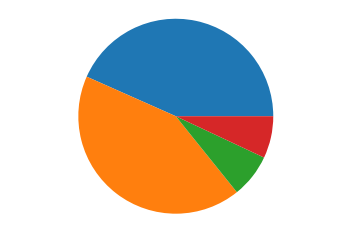

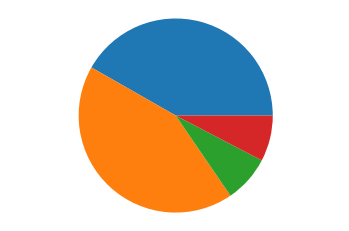

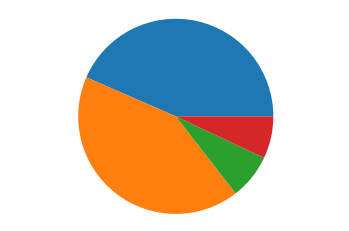

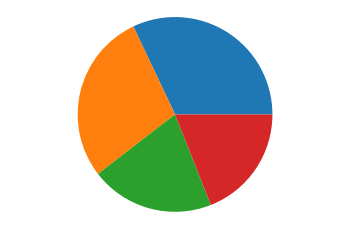

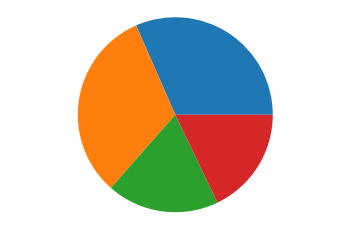

...

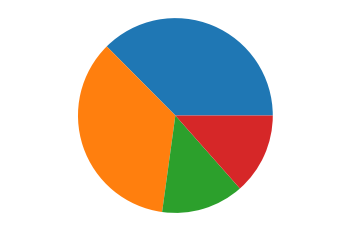

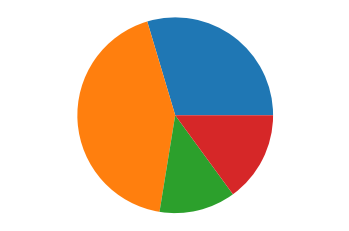

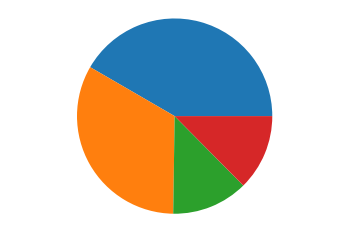

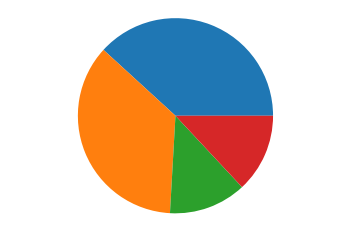

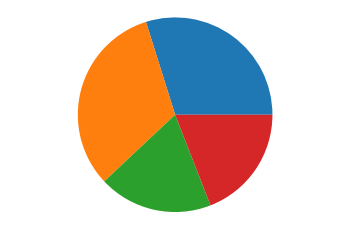

In [17]:
import csv
import matplotlib.pyplot as plt

f = open('subwayfee.csv', encoding = 'cp949')
data = csv.reader(f)

next(data)

label = ['유임승차','유임하차','무임승차','무임하차']

for row in data :
    for i in range(4,8):
        row[i] = int(row[i])
    plt.pie(row[4:8])
    plt.axis('equal')
    plt.show()

### 모든 역의 유무임 승하차 비율을 시각화하기

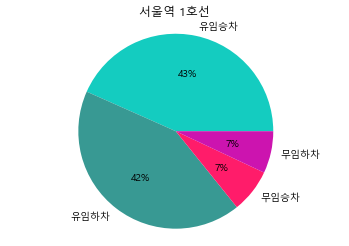

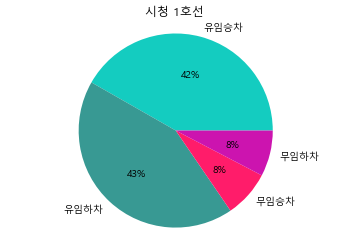

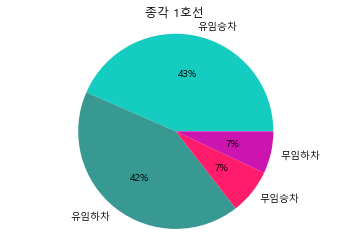

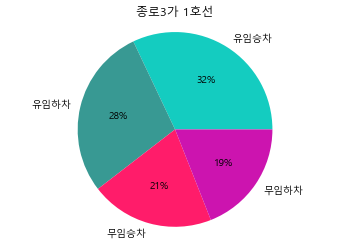

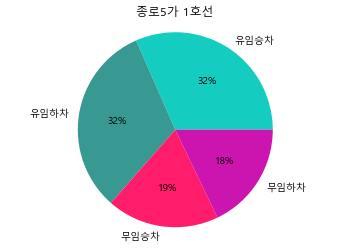

...

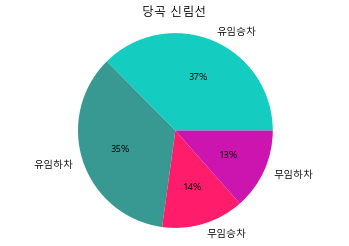

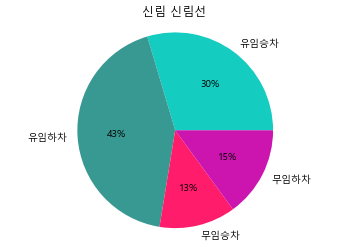

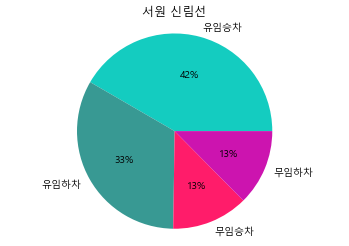

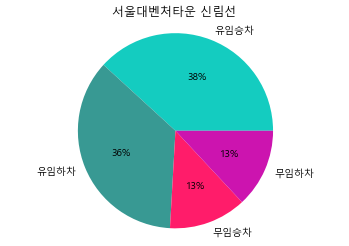

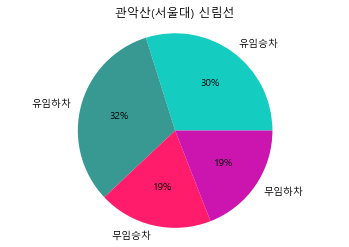

In [18]:
f = open('subwayfee.csv', encoding = 'cp949')
data = csv.reader(f)

next(data)

label = ['유임승차','유임하차','무임승차','무임하차']
c = ['#14CCC0', '#389993', '#ff1C6A', '#CC14AF']

for row in data :
    for i in range(4,8):
        row[i] = int(row[i])
    plt.title(row[3] + ' ' + row[1])
    plt.pie(row[4:8], labels = label, colors = c, autopct = '%1.f%%')
    plt.axis('equal')
    plt.show()

### 이미지 파일로 저장하기

먼저 프로젝트와 같은 위치에 subway_image라는 폴더 생성

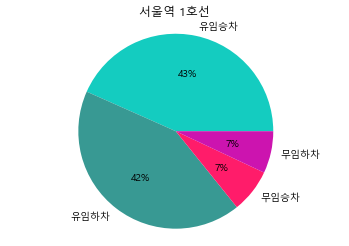

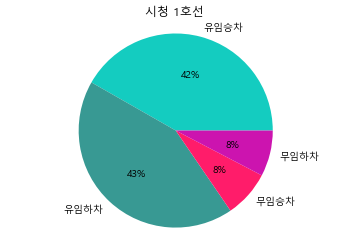

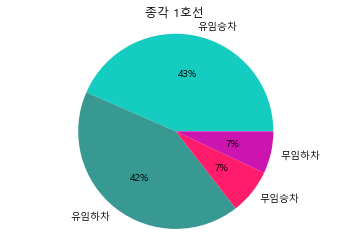

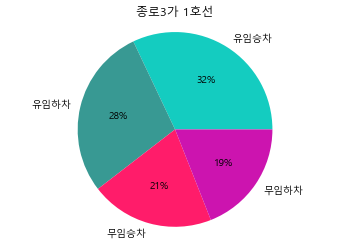

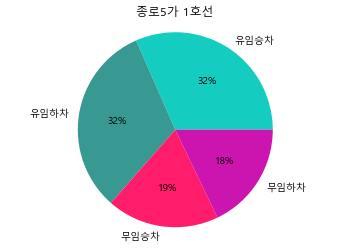

...

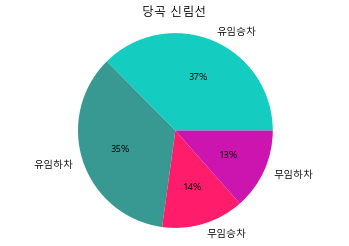

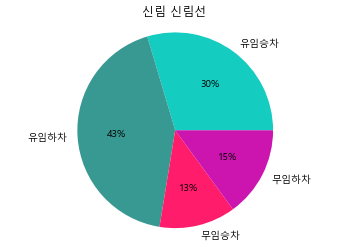

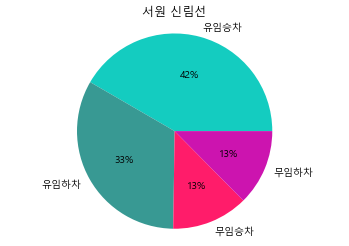

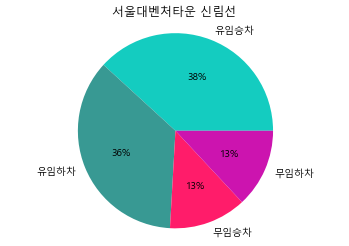

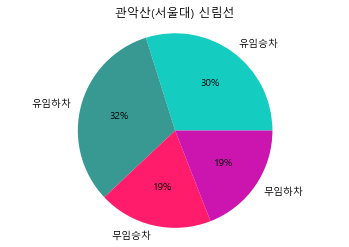

In [20]:
f = open('subwayfee.csv')
data = csv.reader(f)

next(data)

label = ['유임승차','유임하차','무임승차','무임하차']
c = ['#14CCC0', '#389993', '#ff1C6A', '#CC14AF']

for row in data :
    for i in range(4,8):
        row[i] = int(row[i])
    plt.title(row[3] + ' ' + row[1])
    plt.pie(row[4:8], labels = label, colors = c, autopct = '%1.f%%')
    plt.axis('equal')
    plt.savefig('./subway_image/' + row[3] + ' ' + row[1] + '.png')
    plt.show()